In [1]:
pip install pandas numpy scipy matplotlib seaborn plotly windrose

Note: you may need to restart the kernel to use updated packages.



[notice] A new release of pip is available: 24.2 -> 25.1.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [2]:
import pandas as pd 
import numpy as np 
from scipy.stats import zscore
import matplotlib.pyplot as plt
import seaborn as sns
from windrose import WindroseAxes
import plotly.express as px

In [3]:
data_frame = pd.read_csv("../data/benin-malanville.csv")

In [4]:
data_frame.head()

,Timestamp,GHI,DNI,DHI,ModA,ModB,Tamb,RH,WS,WSgust,WSstdev,WD,WDstdev,BP,Cleaning,Precipitation,TModA,TModB,Comments
0,2021-08-09 00:01,-1.2,-0.2,-1.1,0.0,0.0,26.2,93.4,0.0,0.4,0.1,122.1,0.0,998,0,0.0,26.3,26.2,NaN
1,2021-08-09 00:02,-1.1,-0.2,-1.1,0.0,0.0,26.2,93.6,0.0,0.0,0.0,0.0,0.0,998,0,0.0,26.3,26.2,NaN
2,2021-08-09 00:03,-1.1,-0.2,-1.1,0.0,0.0,26.2,93.7,0.3,1.1,0.5,124.6,1.5,997,0,0.0,26.4,26.2,NaN
3,2021-08-09 00:04,-1.1,-0.1,-1.0,0.0,0.0,26.2,93.3,0.2,0.7,0.4,120.3,1.3,997,0,0.0,26.4,26.3,NaN
4,2021-08-09 00:05,-1.0,-0.1,-1.0,0.0,0.0,26.2,93.3,0.1,0.7,0.3,113.2,1.0,997,0,0.0,26.4,26.3,NaN


In [5]:
data_frame.describe()

,GHI,DNI,DHI,ModA,ModB,Tamb,RH,WS,WSgust,WSstdev,WD,WDstdev,BP,Cleaning,Precipitation,TModA,TModB,Comments
count,525600.000000,525600.000000,525600.000000,525600.000000,525600.000000,525600.000000,525600.000000,525600.000000,525600.000000,525600.000000,525600.000000,525600.000000,525600.000000,525600.000000,525600.000000,525600.000000,525600.000000,0.0
mean,240.559452,167.187516,115.358961,236.589496,228.883576,28.179683,54.487969,2.121113,2.809195,0.473390,153.435172,8.582407,994.197199,0.000923,0.001905,35.246026,32.471736,NaN
std,331.131327,261.710501,158.691074,326.894859,316.536515,5.924297,28.073069,1.603466,2.029120,0.273395,102.332842,6.385864,2.474993,0.030363,0.037115,14.807258,12.348743,NaN
min,-12.900000,-7.800000,-12.600000,0.000000,0.000000,11.000000,2.100000,0.000000,0.000000,0.000000,0.000000,0.000000,985.000000,0.000000,0.000000,9.000000,8.100000,NaN
25%,-2.000000,-0.500000,-2.100000,0.000000,0.000000,24.200000,28.800000,1.000000,1.300000,0.400000,59.000000,3.700000,993.000000,0.000000,0.000000,24.200000,23.600000,NaN
50%,1.800000,-0.100000,1.600000,4.500000,4.300000,28.000000,55.100000,1.900000,2.600000,0.500000,181.000000,8.600000,994.000000,0.000000,0.000000,30.000000,28.900000,NaN
75%,483.400000,314.200000,216.300000,463.700000,447.900000,32.300000,80.100000,3.100000,4.100000,0.600000,235.100000,12.300000,996.000000,0.000000,0.000000,46.900000,41.500000,NaN
max,1413.000000,952.300000,759.200000,1342.300000,1342.300000,43.800000,100.000000,19.500000,26.600000,4.200000,360.000000,99.400000,1003.000000,1.000000,2.500000,81.000000,72.500000,NaN


In [6]:
data_frame.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 525600 entries, 0 to 525599
Data columns (total 19 columns):
 #   Column         Non-Null Count   Dtype  
---  ------         --------------   -----  
 0   Timestamp      525600 non-null  object 
 1   GHI            525600 non-null  float64
 2   DNI            525600 non-null  float64
 3   DHI            525600 non-null  float64
 4   ModA           525600 non-null  float64
 5   ModB           525600 non-null  float64
 6   Tamb           525600 non-null  float64
 7   RH             525600 non-null  float64
 8   WS             525600 non-null  float64
 9   WSgust         525600 non-null  float64
 10  WSstdev        525600 non-null  float64
 11  WD             525600 non-null  float64
 12  WDstdev        525600 non-null  float64
 13  BP             525600 non-null  int64  
 14  Cleaning       525600 non-null  int64  
 15  Precipitation  525600 non-null  float64
 16  TModA          525600 non-null  float64
 17  TModB          525600 non-nul

In [7]:
data_frame = data_frame.drop(["Comments"], axis=1)

In [8]:
data_frame.isnull().sum()

Timestamp        0
GHI              0
DNI              0
DHI              0
ModA             0
ModB             0
Tamb             0
RH               0
WS               0
WSgust           0
WSstdev          0
WD               0
WDstdev          0
BP               0
Cleaning         0
Precipitation    0
TModA            0
TModB            0
dtype: int64

In [9]:
data_frame=data_frame.dropna()
data_frame.isnull().sum()

Timestamp        0
GHI              0
DNI              0
DHI              0
ModA             0
ModB             0
Tamb             0
RH               0
WS               0
WSgust           0
WSstdev          0
WD               0
WDstdev          0
BP               0
Cleaning         0
Precipitation    0
TModA            0
TModB            0
dtype: int64

In [10]:
data_frame.head()

,Timestamp,GHI,DNI,DHI,ModA,ModB,Tamb,RH,WS,WSgust,WSstdev,WD,WDstdev,BP,Cleaning,Precipitation,TModA,TModB
0,2021-08-09 00:01,-1.2,-0.2,-1.1,0.0,0.0,26.2,93.4,0.0,0.4,0.1,122.1,0.0,998,0,0.0,26.3,26.2
1,2021-08-09 00:02,-1.1,-0.2,-1.1,0.0,0.0,26.2,93.6,0.0,0.0,0.0,0.0,0.0,998,0,0.0,26.3,26.2
2,2021-08-09 00:03,-1.1,-0.2,-1.1,0.0,0.0,26.2,93.7,0.3,1.1,0.5,124.6,1.5,997,0,0.0,26.4,26.2
3,2021-08-09 00:04,-1.1,-0.1,-1.0,0.0,0.0,26.2,93.3,0.2,0.7,0.4,120.3,1.3,997,0,0.0,26.4,26.3
4,2021-08-09 00:05,-1.0,-0.1,-1.0,0.0,0.0,26.2,93.3,0.1,0.7,0.3,113.2,1.0,997,0,0.0,26.4,26.3


In [11]:
cols = ['GHI', 'DNI', 'DHI', 'ModA', 'ModB', 'WS', 'WSgust']

In [12]:
z_scores = zscore(data_frame[cols])
z_df = pd.DataFrame(z_scores, columns=cols)

outlier_mask = (z_df.abs() > 3).any(axis=1)
outliers = data_frame[outlier_mask]


print("Outliers found:", len(outliers))

data_frame = data_frame[~outlier_mask]

data_frame.to_csv('../cleaned data/cleaned-benin-malanville.csv')

Outliers found: 7740


GHI column info:
count    517860.000000
mean        236.234508
std         328.288787
min         -11.100000
25%          -2.000000
50%           0.700000
75%         468.700000
max        1233.000000
Name: GHI, dtype: float64

Missing values: 0
Unique values: [-1.200e+00 -1.100e+00 -1.000e+00 ...  1.219e+03  1.228e+03  1.229e+03]


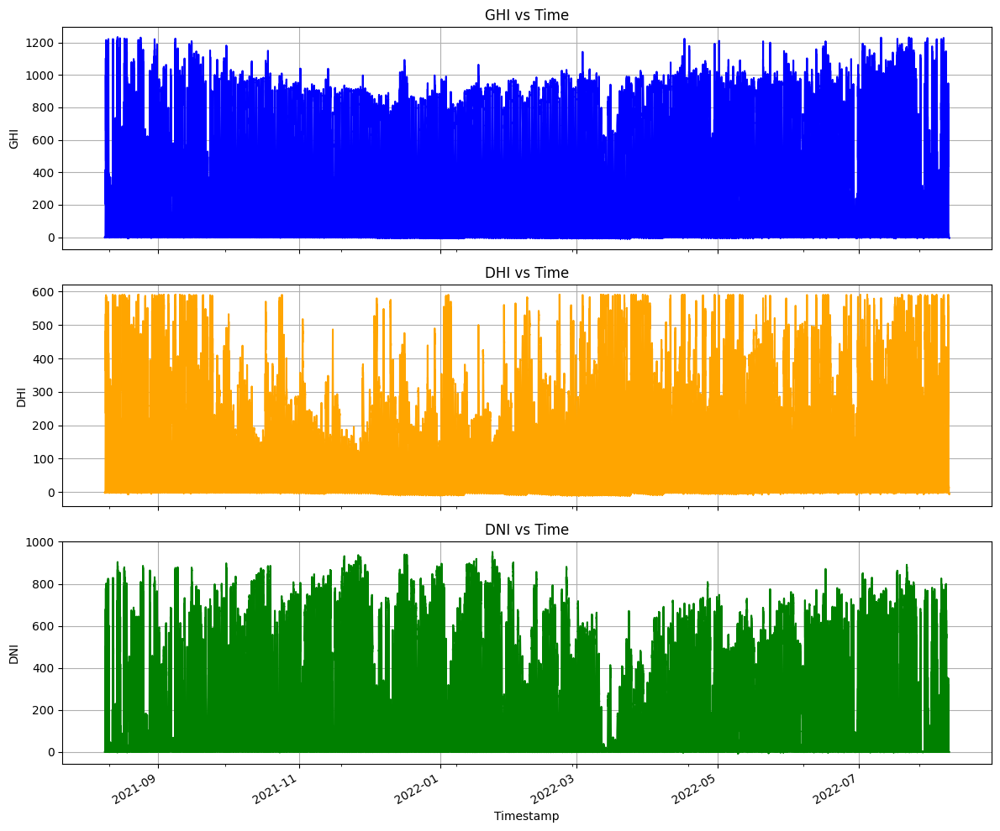

In [13]:
import pandas as pd
import matplotlib.pyplot as plt

data_frame.head()
data_frame.columns = data_frame.columns.str.strip()  # Strip whitespace from all column names

# Check for nulls and unique values
print("GHI column info:")
print(data_frame['GHI'].describe())
print("\nMissing values:", data_frame['GHI'].isnull().sum())
print("Unique values:", data_frame['GHI'].unique())

# Parse Timestamp and set as index
data_frame['Timestamp'] = pd.to_datetime(data_frame['Timestamp'])
data_frame.set_index('Timestamp', inplace=True)

# Plot each column separately
fig, axes = plt.subplots(3, 1, figsize=(12, 10), sharex=True)

data_frame['GHI'].plot(ax=axes[0], title='GHI vs Time', color='blue')
axes[0].set_ylabel('GHI')
axes[0].grid(True)

data_frame['DHI'].plot(ax=axes[1], title='DHI vs Time', color='orange')
axes[1].set_ylabel('DHI')
axes[1].grid(True)

data_frame['DNI'].plot(ax=axes[2], title='DNI vs Time', color='green')
axes[2].set_ylabel('DNI')
axes[2].set_xlabel('Timestamp')
axes[2].grid(True)

plt.tight_layout()
plt.show()


In [14]:
if 'CleanFlag' in data_frame.columns:
    cleaning_avg = data_frame.groupby('CleanFlag')[['ModA', 'ModB']].mean()
    cleaning_avg.plot(kind='bar', title='Cleaning Impact on ModA & ModB')
    plt.ylabel('Average Irradiance')
    plt.grid(True)
    plt.show()

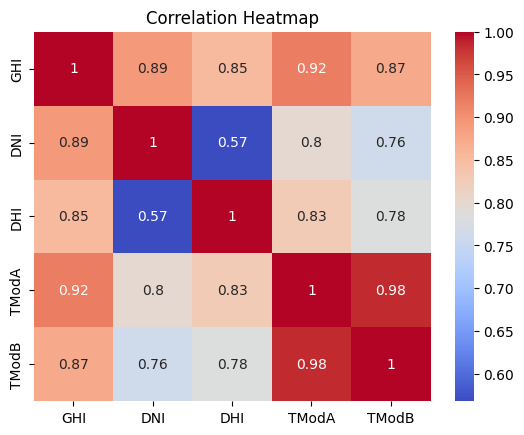

In [15]:
corr_cols = ['GHI', 'DNI', 'DHI', 'TModA', 'TModB']
heat_data = data_frame[[col for col in corr_cols if col in data_frame.columns]]
sns.heatmap(heat_data.corr(), annot=True, cmap='coolwarm')
plt.title("Correlation Heatmap")
plt.show()

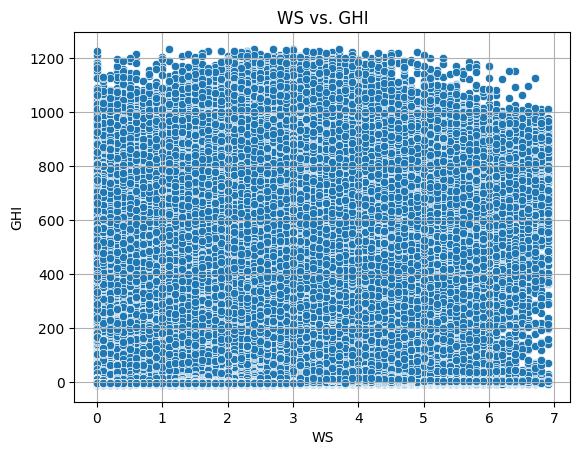

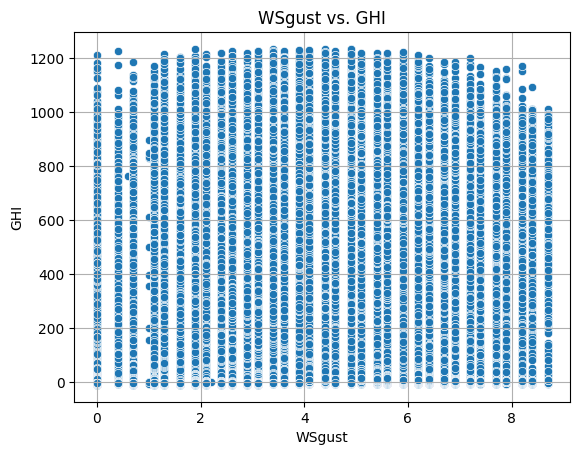

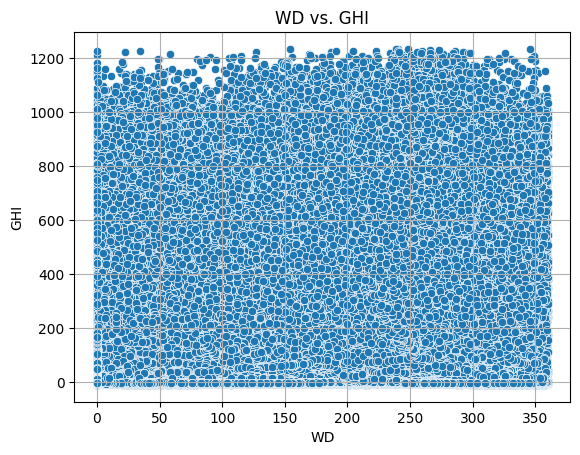

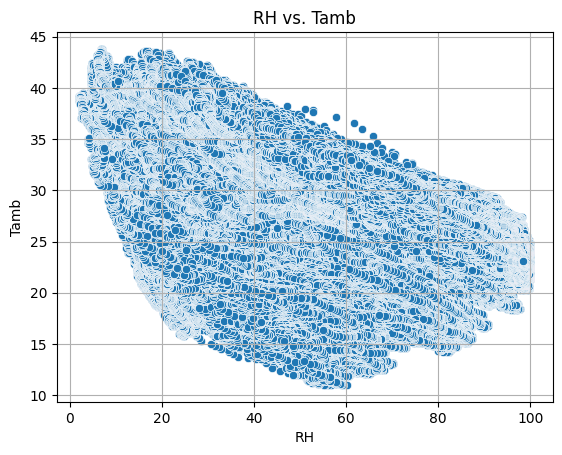

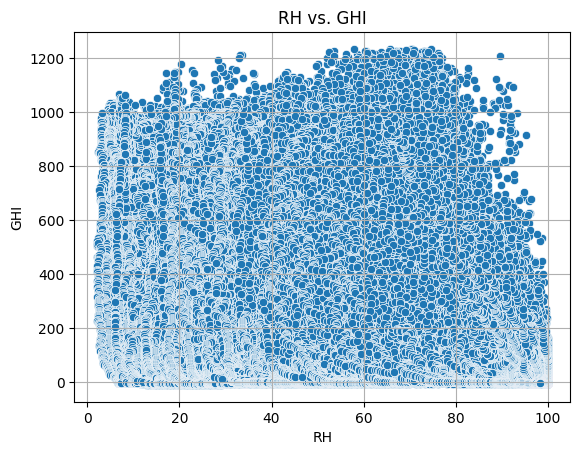

In [16]:
#  Scatter Plots
scatter_pairs = [('WS', 'GHI'), ('WSgust', 'GHI'), ('WD', 'GHI'), ('RH', 'Tamb'), ('RH', 'GHI')]

for x, y in scatter_pairs:
    if x in data_frame.columns and y in data_frame.columns:
        sns.scatterplot(data=data_frame, x=x, y=y)
        plt.title(f'{x} vs. {y}')
        plt.grid(True)
        plt.show()


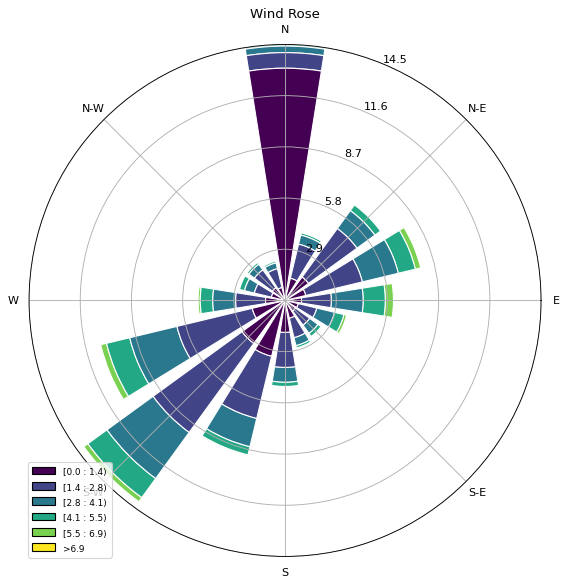

In [17]:
# Wind Rose
if 'WS' in data_frame.columns and 'WD' in data_frame.columns:
    ax = WindroseAxes.from_ax()
    ax.bar(data_frame['WD'], data_frame['WS'], normed=True, opening=0.8, edgecolor='white')
    ax.set_legend()
    plt.title('Wind Rose')
    plt.show()

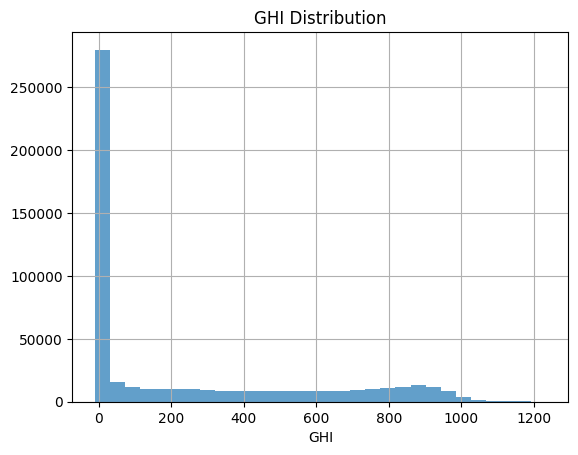

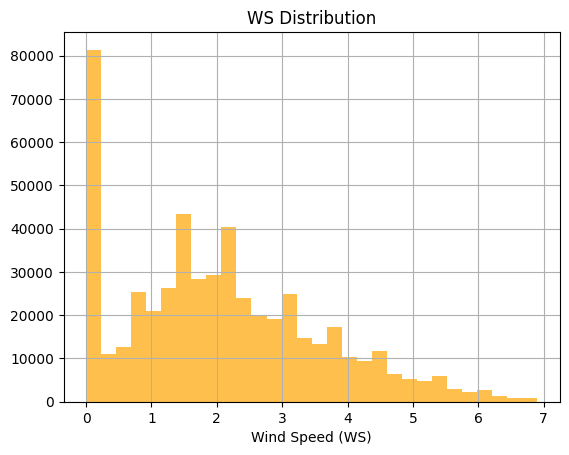

In [18]:
# Histograms

data_frame['GHI'].hist(bins=30, alpha=0.7)
plt.title("GHI Distribution")
plt.xlabel("GHI")
plt.grid(True)
plt.show()

if 'WS' in data_frame.columns:
    data_frame['WS'].hist(bins=30, alpha=0.7, color='orange')
    plt.title("WS Distribution")
    plt.xlabel("Wind Speed (WS)")
    plt.grid(True)
    plt.show()

In [20]:
# Bubble Chart
size_col = 'RH' if 'RH' in data_frame.columns else 'BP' if 'BP' in data_frame.columns else None

if 'GHI' in data_frame.columns and 'Tamb' in data_frame.columns and size_col:
    fig = px.scatter(
        data_frame.reset_index(), x='Tamb', y='GHI',
        size=size_col,
        color=size_col,
        title=f'Bubble Chart: GHI vs. Tamb (Bubble = {size_col})',
        labels={'Tamb': 'Temperature Ambient', 'GHI': 'Global Horizontal Irradiance'}
    )
    fig.show()